#Musical composition synthesis using "The Lonely Shepherd" as base



# Importing all the dependecies that we will be using throughout the project

In [1]:
# Install necessary libraries
!pip install pydub numpy scipy
!apt-get install -y ffmpeg

# Download thinkdsp.py
!wget https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/thinkdsp.py

from pydub import AudioSegment
from pydub.playback import play
import numpy as np
import thinkdsp
import io
import contextlib
import sys
import os
import random
from IPython.display import Audio
import matplotlib.pyplot as plt
import math
from scipy.signal import butter, lfilter, resample
from google.colab import files

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.
--2025-04-01 19:21:50--  https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/thinkdsp.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48554 (47K) [text/plain]
Saving to: ‘thinkdsp.py’

thinkdsp.py         100%[===================>]  47.42K  --.-KB/s    in 0.01s   

2025-04-01 19:21:50 (3.84 MB/s) - ‘thinkdsp.py’ saved [48554/48554]



In [2]:
# Play an AudioSegment via IPython
def play_audiosegment(audio_segment):
    """
    Converts a pydub AudioSegment into an IPython.display.Audio object for playback in notebooks.

    Args:
        audio_segment (AudioSegment): The audio segment to be played.

    Returns:
        Audio: An IPython-compatible audio object that can be played inline.
    """
    samples = np.array(audio_segment.get_array_of_samples())
    return Audio(samples, rate=audio_segment.frame_rate)

In [3]:
@contextlib.contextmanager
def suppress_stdout():
    with open(os.devnull, 'w') as fnull:
        old_stdout = sys.stdout
        sys.stdout = fnull
        try:
            yield
        finally:
            sys.stdout = old_stdout

In [4]:
def createNote(noteName="A4", wave_type="piano", amp=0.5, beats=1.0,
                filter_type=None, cutoff=None, filename=None):
    """
    Synthesizes a musical note using harmonic partials and ADSR shaping.

    This function generates a musical note based on the given name, wave type,
    amplitude, and duration in beats. It builds a waveform using harmonic synthesis
    with optional filtering, applies an ADSR envelope, and returns the audio as a
    pydub AudioSegment. The audio can be optionally saved to a WAV file.

    Args:
        noteName: Name of the note (e.g., "A4", "C#5") within octave 3 to 6.
        wave_type: Type of waveform to synthesize ("sine", "square", "sawtooth", "piano").
        amp: Amplitude of the signal (0.0 to 1.0).
        beats: Duration in beats; assumes 120 BPM (1 beat = 0.5 seconds).
        filter_type: Optional filter to apply ("lowPass" or "highPass").
        cutoff: Cutoff frequency for the filter if used.
        filename: Optional output filename. If None, the audio is kept in memory.

    Returns:
        A pydub AudioSegment object representing the generated note.
    """
    A4_freq = 440.0
    chromatic = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    noteFreqs = {}

    for octave in range(3, 7):
        for i, note in enumerate(chromatic):
            semitone_diff = (octave - 4) * 12 + (i - chromatic.index('A'))
            freq = A4_freq * (2 ** (semitone_diff / 12))
            note_name = f"{note}{octave}"
            noteFreqs[note_name] = round(freq, 2)

    harmonic_profiles = {
        "sine": [1.0],
        "square": [1.0, 0.0, 0.33, 0.0, 0.2],
        "sawtooth": [1.0, 0.5, 0.33, 0.25, 0.2],
        "piano": [1.0, 0.75, 0.5, 0.1, 0.05, 0.03, 0.02, 0.01]
    }

    if noteName not in noteFreqs:
        raise ValueError(f"Note {noteName} not found in generated note frequencies.")
    frequency = noteFreqs[noteName]

    duration = beats * 0.5
    signal = thinkdsp.SinSignal(freq=frequency, amp=amp * harmonic_profiles[wave_type][0])

    for i, coeff in enumerate(harmonic_profiles[wave_type][1:], start=2):
        inharmonicity_factor = 1 + 0.0001 * (i ** 2)
        harmonic_freq = frequency * i * inharmonicity_factor
        harmonic_amp = amp * coeff * np.exp(-i * 0.1)
        signal += thinkdsp.SinSignal(freq=harmonic_freq, amp=harmonic_amp)

    wave = signal.make_wave(duration=duration, framerate=44100)
    wave = apply_adsr_envelope(wave, 0.01, 0.1, 0.7, 0.2)

    if filename:
        with suppress_stdout():
            wave.write(filename=filename)
        audio = AudioSegment.from_wav(filename)
    else:
        buf = io.BytesIO()
        with suppress_stdout():
            wave.write(buf)
        buf.seek(0)
    audio = AudioSegment.from_file(buf, format="wav")

    if filter_type == "lowPass" and cutoff:
        audio = audio.low_pass_filter(cutoff)
    elif filter_type == "highPass" and cutoff:
        audio = audio.high_pass_filter(cutoff)

    return audio

def apply_adsr_envelope(wave, attack_time, decay_time, sustain_level, release_time):
    """
    Applies an ADSR envelope to a given wave.

    Args:
        wave: A thinkdsp.Wave object to apply the envelope to.
        attack_time: Duration of the attack phase in seconds.
        decay_time: Duration of the decay phase in seconds.
        sustain_level: Amplitude level during the sustain phase (0 to 1).
        release_time: Duration of the release phase in seconds.

    Returns:
        A thinkdsp.Wave object with the ADSR envelope applied.
    """
    # Convert times to sample indices
    attack_samples = int(attack_time * wave.framerate)
    decay_samples = int(decay_time * wave.framerate)
    release_samples = int(release_time * wave.framerate)
    sustain_samples = len(wave.ys) - (attack_samples + decay_samples + release_samples)

    if sustain_samples < 0:
        raise ValueError("The sum of attack, decay, and release times exceeds the wave duration.")

    # Create the ADSR envelope
    attack = np.linspace(0, 1, attack_samples)
    decay = np.linspace(1, sustain_level, decay_samples)
    sustain = np.full(sustain_samples, sustain_level)
    release = np.linspace(sustain_level, 0, release_samples)
    envelope = np.concatenate([attack, decay, sustain, release])

    # Apply the envelope to the wave's amplitude
    wave.ys *= envelope

    return wave

In [5]:
# Combine a list of AudioSegments into one
def combine_melody(notes):
    """
    Concatenates a sequence of AudioSegment note objects into a single melody.

    Args:
        notes: A list of AudioSegment objects representing individual notes.

    Returns:
        An AudioSegment containing the combined melody.
    """
    song = AudioSegment.silent(duration=0)
    for note in notes:
        song += note
    return song

# This following Block is for production of visualizations needed

In [6]:
# Visualize waveform (entire and zoomed in)
def visualize_audiosegment(audio_segment, title="Waveform"):
    """
    Visualizes the waveform of an AudioSegment over its full duration.

    Args:
        audio_segment: The AudioSegment object to visualize.
        title: Optional title for the plot. Defaults to "Waveform".

    Returns:
        None. Displays a matplotlib plot of the waveform.
    """
    samples = np.array(audio_segment.get_array_of_samples())
    plt.figure(figsize=(14, 4))
    plt.plot(samples)
    plt.title(title)
    plt.xlabel("Sample Index")
    plt.ylabel("Amplitude")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def plot_waveform_time_domain(audio_segment, title="Waveform", seconds=0.01):
    """
    Plots a zoomed-in view of the waveform for a short time window.

    Args:
        audio_segment: The AudioSegment object to visualize.
        title: Optional title for the plot. Defaults to "Waveform".
        seconds: Duration (in seconds) to display from the beginning of the audio.

    Returns:
        None. Displays a matplotlib plot of the waveform over the specified time window.
    """
    samples = np.array(audio_segment.get_array_of_samples()).astype(np.float32)
    samples /= np.max(np.abs(samples))  # Normalize to -1 to 1
    framerate = audio_segment.frame_rate
    duration = len(samples) / framerate
    time_axis = np.linspace(0, duration, num=len(samples))
    end_sample = int(framerate * seconds)
    time_axis_zoom = time_axis[:end_sample]
    samples_zoom = samples[:end_sample]
    plt.figure(figsize=(10, 4))
    plt.plot(time_axis_zoom, samples_zoom, alpha=0.6)
    plt.title(title + f" (First {seconds*1000:.0f} ms)")
    plt.xlabel("Time (seconds)")
    plt.ylabel("Amplitude")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [7]:
# Create a looped segment from a note (for overlays)
def create_looped_segment(note_segment, total_duration_ms, loop_interval_ms=2000):
    """
    Creates a looped audio segment by repeating a given note segment until a total duration is filled.

    Args:
        note_segment: The AudioSegment representing a single note or musical phrase to loop.
        total_duration_ms: The total desired duration of the resulting audio in milliseconds.
        loop_interval_ms: The duration in milliseconds to repeat for each loop iteration.
            Defaults to 2000 ms.

    Returns:
        An AudioSegment of the specified total duration, composed by repeating the input
        segment at fixed intervals.
    """
    times_to_repeat = math.ceil(total_duration_ms / loop_interval_ms)
    looped_segment = AudioSegment.silent(duration=0)
    for _ in range(times_to_repeat):
        looped_segment += note_segment
    looped_segment = looped_segment[:total_duration_ms]
    return looped_segment

# Apply AM & FM synthesis to an AudioSegment

In [8]:
def apply_am_to_audiosegment(audio_segment, mod_freq=5.0, mod_index=0.5, dynamic_decay=False):
    """
    Applies amplitude modulation (AM) to a mono AudioSegment.

    This function modulates the amplitude of the input audio using a sine wave
    modulator. Optionally, a decaying envelope can be applied to the modulation
    index to simulate natural fading (e.g., piano-like timbre decay).

    Args:
        audio_segment: A mono AudioSegment object to modulate.
        mod_freq: Frequency of the modulation oscillator in Hz.
        mod_index: Depth of modulation (0.0 to 1.0+).
        dynamic_decay: If True, applies an exponential decay to the modulation index.

    Returns:
        A new AudioSegment with amplitude modulation applied.
    """
    samples = np.array(audio_segment.get_array_of_samples()).astype(np.float32)
    samples /= np.max(np.abs(samples))
    duration = len(samples) / audio_segment.frame_rate
    t = np.linspace(0, duration, len(samples))
    if dynamic_decay:
        envelope = np.exp(-6* t)  # fast exponential decay
        modulator = 1 + (mod_index * envelope) * np.sin(2 * np.pi * mod_freq * t)
    else:
        modulator = 1 + mod_index * np.sin(2 * np.pi * mod_freq * t)
    # modulator = 1 + mod_index * np.sin(2 * np.pi * mod_freq * t)
    modulated_samples = samples * modulator
    modulated_samples /= np.max(np.abs(modulated_samples))
    modulated_int16 = (modulated_samples * 32767).astype(np.int16)
    new_segment = AudioSegment(
        modulated_int16.tobytes(),
        frame_rate=audio_segment.frame_rate,
        sample_width=2,
        channels=1
    )
    return new_segment

In [9]:
def apply_fm_to_audiosegment(audio_segment, mod_freq=5.0, mod_index=50.0, carrier_freq=440.0):
    """
    Applies frequency modulation (FM) synthesis to an AudioSegment.

    This function modulates the phase of a carrier sine wave using a low-frequency
    modulator and multiplies it with the original signal, preserving the original
    amplitude envelope. The result is a timbrally richer version of the input audio.

    Args:
        audio_segment: The input AudioSegment to be modulated. It is converted to mono.
        mod_freq: The frequency of the modulation signal in Hz.
        mod_index: The modulation index, which controls the depth of frequency deviation.
        carrier_freq: The carrier frequency in Hz used for FM synthesis.

    Returns:
        A new AudioSegment with FM synthesis applied.
    """
    # Convert to mono, extract samples
    audio_segment = audio_segment.set_channels(1)
    samples = np.array(audio_segment.get_array_of_samples()).astype(np.float32)
    samples /= np.max(np.abs(samples))

    sr = audio_segment.frame_rate
    duration = len(samples) / sr
    t = np.linspace(0, duration, len(samples))

    # Frequency modulation: modulate phase of carrier
    modulator = np.sin(2 * np.pi * mod_freq * t)
    instantaneous_phase = 2 * np.pi * carrier_freq * t + mod_index * modulator
    carrier = np.sin(instantaneous_phase)

    # Multiply original samples by FM carrier to preserve source envelope
    fm_output = samples * carrier
    fm_output /= np.max(np.abs(fm_output))

    int_samples = (fm_output * 32767).astype(np.int16)
    return AudioSegment(
        int_samples.tobytes(),
        frame_rate=sr,
        sample_width=2,
        channels=1
    )

# Tools for graular synthesis

In [10]:
def my_gran(source, win_size, hop_cut, hop_paste, play_order):
    """
    Applies granular synthesis to an input signal using randomized grain extraction and placement.

    This function segments the input signal into overlapping grains, applies a Hanning window
    to each, optionally randomizes the cut/paste hops, and reconstructs a new signal with modified
    temporal characteristics and amplitude variation.

    Args:
        source: A 1D NumPy array representing the input audio signal.
        win_size: The size (in samples) of each grain window.
        hop_cut: The average hop size (in samples) between source grains.
        hop_paste: The average hop size (in samples) between pasted grains in the output.
        play_order: Reserved for future control of playback order (e.g., reverse, shuffle).

    Returns:
        A NumPy array containing the granulated output signal with new timing and amplitude structure.
    """
    n_hop = int((len(source) - win_size) / hop_cut) + 1
    length = int(n_hop * hop_paste + win_size)

    rslt = np.zeros(length, dtype=np.float32)  # Ensure NumPy array with correct dtype
    temp = np.zeros(length, dtype=np.float32)

    for i in range(n_hop):
        # Apply slight randomness to hop sizes
        rand_hop_cut = max(1, i * hop_cut + random.randint(-hop_cut, hop_cut))
        rand_hop_paste = max(1, i * hop_paste + random.randint(-hop_paste, hop_paste))
        # Ensure index bounds are valid
        start_src = rand_hop_cut
        end_src = min(start_src + win_size, len(source))
        hanning_window_size = end_src - start_src
        start_dst = rand_hop_paste
        end_dst = min(start_dst + hanning_window_size, length)
        # Convert grain to a NumPy array to avoid TypeError
        gran = np.array(source[start_src:end_src], dtype=np.float32)
        gran = np.multiply(gran, np.hanning(hanning_window_size))
        # Apply random amplitude variation
        gain = random.uniform(0.8, 1.2)
        temp[start_dst:end_dst] = gain * gran
        # Apply Hanning window and add to result
        rslt = np.add(rslt, temp)

    return rslt

# BeatByte overlay synthesis function

In [11]:
def apply_bitwise_harmony_overlay_pydub(audio):
    """
    Applies a bitwise harmony overlay to a Pydub AudioSegment.

    This function adds harmonic richness and digital texture by blending the original
    audio with a bitwise-generated signal. The overlay is created using bitwise operations
    on a time-derived bytebeat signal and then mixed with the original waveform.

    Args:
        audio: A Pydub AudioSegment object. Will be converted to mono internally.

    Returns:
        A new Pydub AudioSegment object with the bitwise harmony overlay applied.
    """
    # Convert to mono and get raw samples
    audio = audio.set_channels(1)
    samples = np.array(audio.get_array_of_samples()).astype(np.float32)

    # Normalize samples to [-1.0, 1.0]
    samples /= np.max(np.abs(samples))

    # Prepare time array
    sample_rate = audio.frame_rate
    t = np.arange(len(samples))
    t_byte = (t * 8000) // sample_rate

    # Generate bitwise harmony overlay
    overlay = ((t_byte * 5) & (t_byte >> 4)) | ((t_byte * 3) & (t_byte >> 6))
    overlay = (overlay % 256) / 128.0 - 1.0  # Normalize to [-1, 1]

    # Blend original and overlay
    enriched = 0.8 * samples + 0.2 * overlay
    enriched = np.clip(enriched, -1.0, 1.0)

    # Convert back to int16
    enriched_int16 = (enriched * 32767).astype(np.int16)

    # Create a new AudioSegment
    return AudioSegment(
        enriched_int16.tobytes(),
        frame_rate=sample_rate,
        sample_width=2,  # 16-bit audio
        channels=1
    )

# Fade in and out using a cosine curve

In [12]:
def fade_in_out(signal, fade_length):
    """
    Applies a symmetric cosine fade-in and fade-out to the beginning and end of the signal.

    Args:
        signal: A 1D NumPy array of normalized audio samples in the range [-1, 1].
        fade_length: Number of samples over which to apply the fade-in and fade-out.

    Returns:
        A NumPy array with fade-in and fade-out applied.
    """
    fade_in = (1 - np.cos(np.linspace(0, np.pi, fade_length))) * 0.5
    fade_out = np.flip(fade_in)
    signal[:fade_length] *= fade_in
    signal[-fade_length:] *= fade_out
    return signal

def apply_fade_to_audiosegment(audio_segment, fade_length=2000):
    """
    Applies a symmetric fade-in and fade-out to a pydub AudioSegment.

    Args:
        audio_segment: A mono AudioSegment object representing the input audio.
        fade_length: Duration of the fade in number of samples (not milliseconds).

    Returns:
        A new AudioSegment with cosine fade-in and fade-out applied.
    """
    samples = np.array(audio_segment.get_array_of_samples()).astype(np.float32)
    samples /= np.max(np.abs(samples))
    faded_samples = fade_in_out(samples, fade_length=fade_length)
    faded_int16 = (faded_samples * 32767).astype(np.int16)
    faded_audio = AudioSegment(
        faded_int16.tobytes(),
        frame_rate=audio_segment.frame_rate,
        sample_width=2,
        channels=1
    )
    return faded_audio

# Low-pass filter function (using scipy)

In [13]:
def lowpass_filter(data, cutoff_freq, sample_rate, order=5):
    """
    Applies a low-pass Butterworth filter to an AudioSegment.

    Args:
        data: A pydub AudioSegment object containing the audio to be filtered.
        cutoff_freq: The cutoff frequency of the low-pass filter in Hz.
        sample_rate: The sample rate of the audio signal in Hz.
        order: The order of the Butterworth filter. Higher order results in a steeper roll-off. Defaults to 5.

    Returns:
        A NumPy array containing the filtered audio samples as float32 values.
    """
    nyquist = 0.5 * sample_rate
    normal_cutoff = cutoff_freq / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    data_array = np.array(data.get_array_of_samples()).astype(np.float32)
    filtered_data = lfilter(b, a, data_array)
    return filtered_data

# Music techniques to enrich compositions

In [14]:
def transpose_notes(note_list, semitone_shift, note_beat_map):
    """
    Transposes a list of note names by a given number of semitones and returns
    corresponding createNote objects with preserved rhythm.

    Each note is transposed chromatically while preserving its duration from
    the provided beat mapping. The output is a new list of createNote calls
    with updated pitches and original beat lengths.

    Args:
        note_list: A list of note strings (e.g., "G4", "C#5") to be transposed.
        semitone_shift: An integer number of semitones to shift each note.
                        Positive values transpose up, negative values down.
        note_beat_map: A dictionary mapping original note strings to their beat durations.

    Returns:
        A list of createNote objects with transposed pitches and original beat lengths.
    """
    chromatic = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']

    def parse_note(note):
        if note[1] in '#b':
            pitch = note[:2]
            octave = int(note[2:])
        else:
            pitch = note[0]
            octave = int(note[1:])
        return pitch, octave

    def transpose_note(note):
        pitch, octave = parse_note(note)
        idx = chromatic.index(pitch)
        new_idx = idx + semitone_shift
        octave_shift, new_pitch_idx = divmod(new_idx, 12)
        new_octave = octave + octave_shift
        new_note = f"{chromatic[new_pitch_idx]}{new_octave}"
        beat_length = note_beat_map[note]
        return createNote(new_note, "sawtooth", beats=beat_length)

    return [transpose_note(n) for n in note_list]

In [15]:
def retrograde_sequence(notes):
    """
    Creates a retrograde version of a note sequence by appending the reversed sequence
    to the original.

    Args:
        notes: A list of note representations (e.g., strings or objects) forming a melody.

    Returns:
        A new list containing the original note sequence followed by its retrograde (reversed) form.
    """
    return notes + notes[::-1]

In [16]:
def fractalize_melody(melody, note_beat_map, depth=2):
    """
    Recursively fractalizes a melody by applying melodic inversion at each level,
    preserving compatibility with createNote. Returns a list of createNote objects.

    This method builds a self-similar musical structure by inverting the motif around
    its central pitch recursively and concatenating the results, resulting in layered,
    mirrored patterns with preserved rhythmic identity.

    Args:
        melody: A list of note names as strings (e.g., ['C4', 'E4', 'G4']).
        note_beat_map: A dictionary mapping note names to beat durations.
        depth: The number of recursive fractalization levels to apply.

    Returns:
        A list of createNote objects representing the fractalized melody.
    """
    chromatic = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    chromatic_map = {note: i for i, note in enumerate(chromatic)}

    def note_to_midi(note):
        if note[1] in '#b':
            pitch = note[:2]
            octave = int(note[2:])
        else:
            pitch = note[0]
            octave = int(note[1:])
        return 12 * (octave + 1) + chromatic_map[pitch]

    def midi_to_note(midi):
        note = chromatic[midi % 12]
        octave = midi // 12 - 1
        return f"{note}{octave}"

    def invert(motif):
        midi_values = [note_to_midi(n) for n in motif]
        center = sum(midi_values) // len(midi_values)
        inverted_midi = [2 * center - m for m in midi_values]
        return [midi_to_note(m) for m in inverted_midi]

    def recurse(motif, level):
        if level == 0:
            return motif
        transformed = invert(motif)
        return motif + recurse(transformed, level - 1)

    expanded_note_names = recurse(melody, depth)

    return [
        createNote(noteName=n, wave_type="sawtooth", beats=note_beat_map[n])
        for n in expanded_note_names if n in note_beat_map
    ]

In [17]:
def audiosegment_to_array(segment):
    """
    Converts a pydub AudioSegment to a normalized NumPy array.

    Args:
        segment: A mono AudioSegment object to be converted.

    Returns:
        A NumPy array of float32 values normalized to the range [-1.0, 1.0].
    """
    samples = np.array(segment.get_array_of_samples()).astype(np.float32)
    samples /= np.max(np.abs(samples))
    return samples

def array_to_audiosegment(arr, frame_rate=44100):
    """
    Converts a NumPy array of audio samples to a mono AudioSegment.

    Args:
        arr: A NumPy array of audio samples in the range [-1.0, 1.0].
        frame_rate: The sampling rate of the audio in Hz. Defaults to 44100.

    Returns:
        A mono AudioSegment constructed from the input array.
    """
    arr = np.clip(arr, -1.0, 1.0)
    int_samples = (arr * 32767).astype(np.int16)
    return AudioSegment(
        int_samples.tobytes(),
        frame_rate=frame_rate,
        sample_width=2,
        channels=1
    )

# Composition definition
Here, we break down our composition into 3 segments. The base notes are taken from the infamous song : **The Lonely Shepherd**. We devide the melody in three segments and apply different compositional techniques and synthetic techniques to each. Here is a high level overview of them

$$
\begin{array}{|c|c|c|}
\hline
\textbf{Section} & \textbf{Compositional Technique} & \textbf{Synthetic Technique} \\
\hline
\text{Intro section} & \text{Fractalization} & \text{Granular synthesis} \\
\hline
\text{Bridge section} & \text{Transposition} & \text{ByteBeat} \\
\hline
\text{Outro section} & \text{Retrograde} & \text{FM synthesis} \\
\hline
\end{array}
$$

We also use a left hand note of C3 that keeps playing periodically, we apply AM synthesis to each note stroke to stimulate the fading effect of a piano key press.

In [18]:
# Create notes with sawtooth for a pan flute-like timbre
G4 = createNote("G4", "sawtooth", beats=3.0)
A4 = createNote("A4", "sawtooth", beats=1.0)
B4 = createNote("B4", "sawtooth", beats=2.0)
C5 = createNote("C5", "sawtooth", beats=2.0)
D5 = createNote("D5", "sawtooth", beats=3.0)
E5 = createNote("E5", "sawtooth", beats=1.0)
F5 = createNote("F5", "sawtooth", beats=2.0)
G5 = createNote("G5", "sawtooth", beats=4.0)
# A mapping required by out compositional techniques functions to preserve note duration in notes that weren't a part of the original composition
note_beat_map = {
    "G4": 3.0,
    "A4": 1.0,
    "B4": 2.0,
    "C5": 2.0,
    "D5": 3.0,
    "E5": 1.0,
    "F5": 2.0,
    "G5": 4.0
}

# Define a loopable melody from the created notes
intro_notes = [
    "G4", "A4", "B4", "C5", "B4", "A4", "G4", "E5",
    "D5", "C5", "B4", "A4", "G4", "F5", "E5", "D5",
    "C5", "B4", "A4", "G4", "E5", "D5", "C5", "B4", "A4", "G4", "F5", "E5"
]
melody_intro = (fractalize_melody(intro_notes, note_beat_map, 3))
bridge_notes = ["D5", "C5", "B4",
    "A4", "G4", "F5", "E5", "D5", "C5", "B4", "A4",
    "G4", "A4", "B4", "C5", "B4", "A4", "G4", "E5",
    "D5", "C5", "B4", "A4", "G4", "F5"]
melody_bridge = (
    transpose_notes(bridge_notes, -2, note_beat_map) +
    transpose_notes(bridge_notes, 0, note_beat_map) +
    transpose_notes(bridge_notes, 2, note_beat_map)
)
melody_outro = retrograde_sequence([
    D5,
    A4, G4, F5, E5, D5,
    A4, G4, F5, E5, D5, C5, B4, A4,
    G4, E5, D5, C5, B4, A4, G4, F5,
    E5
])

# Applying Granular synthesis the intro section
Because granualr synthesis produces harsh chippering effect, we use a large window size to smooth out the effect a bit, and apply it in an envelop such that it peaks in the middle of the intro section but has barely any noticable effect towards the beggining and the end of the intro section. Leading to a smoother transition to the bridge melody

In [19]:
def match_length(source, target_len):
    """
    Resamples the input array to match a target length using linear interpolation.

    Args:
        source: The input 1D array to be resampled.
        target_len: The desired length of the output array.

    Returns:
        A new array with length equal to `target_len`, resampled from `source`.
    """
    return resample(source, target_len)

def apply_granular_crossfade(original_arr, granulated_arr):
    """
    Applies a symmetric granular crossfade between an original and a granulated audio signal.

    The function uses a cosine-based envelope to fade in the granulated signal
    toward the center and fade it back out symmetrically. The blend never exceeds
    a specified maximum contribution from the granulated signal.

    Args:
        original_arr: The original audio signal as a 1D array.
        granulated_arr: The granulated audio signal to blend in.

    Returns:
        A 1D array containing the blended audio signal with a smooth transition
        into and out of the granulated texture.
    """
    if len(granulated_arr) != len(original_arr):
        granulated_arr = match_length(granulated_arr, len(original_arr))

    n = len(original_arr)
    t = np.linspace(0, 1, n)
    sharpness = 2.5  # >1 = sharper peak, try values between 2–5
    mix_env = 0.05 * (0.5 * (1 - np.cos(2 * np.pi * t))) ** sharpness
    return (1 - mix_env) * original_arr + mix_env * granulated_arr

In [20]:
# granulate intro segment
full_audio = sum(melody_intro)  # Concatenate AudioSegments
source_arr = audiosegment_to_array(full_audio)

# Apply granular synthesis
granulated_arr = my_gran(
    source=source_arr,
    win_size=8192,
    hop_cut=8192 // 4,
    hop_paste=int(8192 / 4 * 1.2),  # This stretches time slightly
    play_order=0
)

melody_intro = apply_granular_crossfade(source_arr, granulated_arr)
# Convert back to AudioSegment
melody_intro = array_to_audiosegment(melody_intro)
# melody_intro = apply_granular_crossfade()

# Composition Plan: Intro, Bridge, End

In [21]:
# Partition the melody into three equal sections
intro_melody = melody_intro    # Intro: first 64 notes
bridge_melody = melody_bridge # Bridge: next 64 notes
end_melody = melody_outro   # End: final 64 notes

# Generate each section using the existing combine_melody function
intro_section = combine_melody(intro_melody)
bridge_section = combine_melody(bridge_melody)
end_section = combine_melody(end_melody)

# Apply distinct effects to each section for variety:
# - Intro: Apply a gentle fade to set the mood.
intro_section = apply_fade_to_audiosegment(intro_section, fade_length=2000)
# - Bridge: Apply amplitude modulation to create a dynamic transition.
bridge_section = apply_am_to_audiosegment(bridge_section, mod_freq=5.0, mod_index=0.4)
# - End: Apply fade again to create a smooth conclusion.
end_section = apply_fade_to_audiosegment(end_section, fade_length=2000)

# Concatenate the sections to form the full composition
composition_plan = {
    "intro": intro_section, # already gran synthesis is applied
    "bridge": apply_bitwise_harmony_overlay_pydub(bridge_section), # adding beatbyte overlay
    "end": apply_fm_to_audiosegment(end_section, mod_freq=1.2,mod_index=8.0,carrier_freq=0) # apply FM synthesis.
}

final_composition = composition_plan["intro"] + composition_plan["bridge"] + composition_plan["end"]




# Overlays & Effects

In [22]:
# Add a piano overlay to the final composition
c4 = createNote("C3", wave_type="piano", beats=4.0)
piano_note = apply_am_to_audiosegment(c4, mod_freq=5.0, mod_index=0.8, dynamic_decay=True)
final_duration_ms = len(final_composition)
looped_piano_final = create_looped_segment(piano_note, total_duration_ms=final_duration_ms, loop_interval_ms=2000)
final_composition = final_composition.overlay(looped_piano_final)

In [23]:
# apply further processing: with a calm sine wave
def generate_sine_wave(freq, duration, rate=44100):
    """
    Generates a sine wave at a given frequency and duration.

    Args:
        freq: Frequency of the sine wave in Hz.
        duration: Duration of the wave in seconds.
        rate: Sampling rate in samples per second (default is 44100).

    Returns:
        A NumPy array containing the sine wave samples.
    """
    t = np.linspace(0, duration, int(rate * duration), endpoint=False)
    wave = np.sin(2 * np.pi * freq * t)
    return wave

# Extract samples and generate a sine wave of matching duration
samples = np.array(final_composition.get_array_of_samples()).astype(np.float32)
samples /= np.max(np.abs(samples))
sample_rate = final_composition.frame_rate
duration = len(samples) / sample_rate
sine_wave = generate_sine_wave(freq=220, duration=duration, rate=sample_rate)
sine_wave = sine_wave[:len(samples)]
combined = 0.9 * samples + 0.1 * sine_wave
combined = combined / np.max(np.abs(combined))
combined_int16 = (combined * 32767).astype(np.int16)
calm_audio = AudioSegment(
    combined_int16.tobytes(),
    frame_rate=sample_rate,
    sample_width=2,
    channels=1
)
final_composition = apply_fade_to_audiosegment(calm_audio, fade_length=2000)


In [24]:
#  apply a low-pass filter to smooth the overall sound
cutoff_freq = 1000  # Hz for a mellow tone
combined_filtered = lowpass_filter(final_composition, cutoff_freq, sample_rate)
combined_filtered = combined_filtered / np.max(np.abs(combined_filtered))
filtered_int16 = (combined_filtered * 32767).astype(np.int16)
final_composition = AudioSegment(
    filtered_int16.tobytes(),
    frame_rate=sample_rate,
    sample_width=2,
    channels=1
)
final_composition = apply_fade_to_audiosegment(final_composition, fade_length=2000)

# Playback & Visualization

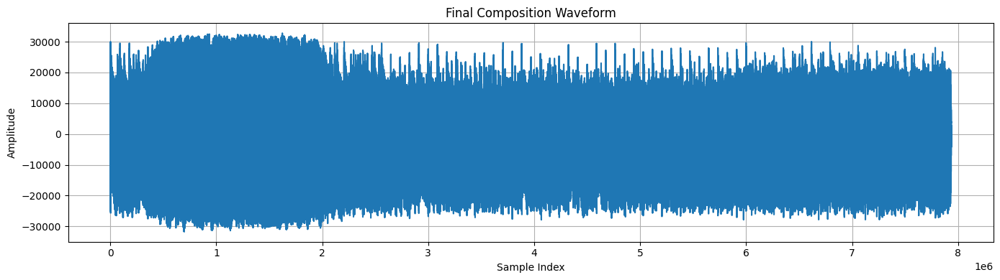

In [25]:
# Visualize the waveform of the final composition
visualize_audiosegment(final_composition, title="Final Composition Waveform")


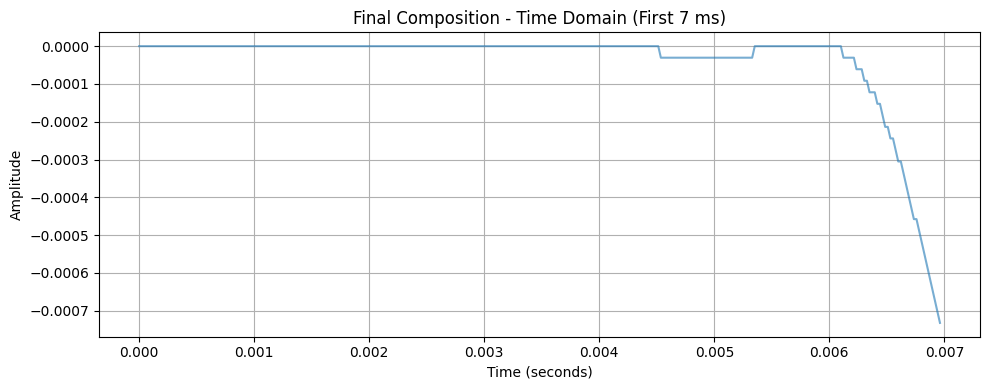

In [26]:
plot_waveform_time_domain(final_composition, title="Final Composition - Time Domain", seconds=0.007)

In [27]:
# Play the final composition with the integrated composition plan
play_audiosegment(final_composition)

In [28]:
#Download WAV file
final_composition.export("final_composition.wav", format="wav")

files.download("final_composition.wav")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>